parse session data,

session_start_end:
    metric: metric_ts_df ts, metric)

In [27]:
import json
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


In [28]:
from datetime import datetime 
def get_metric_df(metric_json: dict) -> pd.DataFrame:
    """
    create a metric df based on metric json
    """
    posture_data_lst = []
    for ts, score in metric_json.items():
        posture_data_lst.append((ts, score))
    posture_data_df = pd.DataFrame(posture_data_lst, columns=['ts', 'value'])
    posture_data_df['ts'] = posture_data_df['ts'].apply(int)
    posture_data_df['session_time'] = posture_data_df['ts'] - posture_data_df['ts'].min()
    return posture_data_df.sort_values("ts")

def get_data_date(filename: str) -> str:
    """get the date str from data file."""
    start_time_ts = filename.split("_")[1]
    if start_time_ts.isdigit():
        start_time_ts_int = int(start_time_ts)
        return str(datetime.fromtimestamp(start_time_ts_int).date())
    else:
        raise ValueError(f"unable to parse {start_time_ts} as ts")
        

def ts_to_datetime(ts: int, return_str: bool=False) -> datetime:
    """ convert epoch timestamp to datetime object"""
    datetime_obj = datetime.fromtimestamp(ts)
    if return_str:
        return str(datetime_obj)
    else:
        return datetime_obj
        
from pathlib import Path
        
def get_session_metric_data(session_name: str) -> pd.DataFrame:
    """
    read the folder that contains data for a single session
    """
    posture_data_files = list(Path(session_name).glob(f"*.json"))
    posture_data_dict = dict()
    session_date = get_data_date(session_name.name)
    for file in posture_data_files:
        metric_name = file.name.split(".")[0]
        with open(file) as infile:
            json_data = json.load(infile)
            metric_df = get_metric_df(json_data)
            metric_df['metric_name'] = metric_name
            metric_df['date'] = session_date
            metric_df['session_name'] = session_name.name
            posture_data_dict[metric_name] = metric_df
    return posture_data_dict


In [29]:
import os
DATA_ROOT_DIR = '../posture_data'
ARCHVE_DATA_ROOT_DIR = '../archive/test_dir'

In [30]:
session_data_dirs = list(Path(DATA_ROOT_DIR).glob(f"session_16*_*"))
len(session_data_dirs)
session_data_dirs[:5]

[WindowsPath('../posture_data/session_1643504032_1643504038'),
 WindowsPath('../posture_data/session_1643504040_1643504172'),
 WindowsPath('../posture_data/session_1643504176_1643504176'),
 WindowsPath('../posture_data/session_1643504291_1643504523'),
 WindowsPath('../posture_data/session_1643505119_1643505125')]

In [31]:
from collections import defaultdict
metric_dfs = defaultdict(lambda : [])

for session_data_dir in session_data_dirs:
    start_time = int(session_data_dir.name.split("_")[1])
    if start_time < 1645717723: #_1643522275:
            continue
    data_date = get_data_date(session_data_dir.name)
    metric_data = get_session_metric_data(session_data_dir)
    if 'alert_ts' in metric_data and metric_data['alert_ts'].shape[0] >= 10:
        print(metric_data['alert_ts']['ts'].min())
        session_duration_seconds= metric_data['alert_ts'].shape[0]
        print(f"session score: {(metric_data['alert_ts']['value']==0).sum()} / {session_duration_seconds}")
        last_metric_data = metric_data
        for metric, df in last_metric_data.items():
            metric_dfs[metric].append(df)
            print(f"\t {metric}: {df.shape[0]}")
        print("\n\n\n")
        

1646066094
session score: 23284 / 41521
	 alert_ts: 41521
	 good_posture: 41523
	 headdown: 42321
	 headdown_seconds: 42140
	 landmark_0_x: 41523
	 landmark_0_y: 41522
	 landmark_10_x: 41522
	 landmark_10_y: 41523
	 landmark_11_x: 41522
	 landmark_11_y: 41523
	 landmark_12_x: 41522
	 landmark_12_y: 41523
	 landmark_13_x: 41522
	 landmark_13_y: 41522
	 landmark_14_x: 41523
	 landmark_14_y: 41523
	 landmark_1_x: 41522
	 landmark_1_y: 41522
	 landmark_2_x: 41522
	 landmark_2_y: 41522
	 landmark_3_x: 41522
	 landmark_3_y: 41522
	 landmark_4_x: 41520
	 landmark_4_y: 41523
	 landmark_5_x: 41522
	 landmark_5_y: 41523
	 landmark_6_x: 41522
	 landmark_6_y: 41522
	 landmark_7_x: 41523
	 landmark_7_y: 41522
	 landmark_8_x: 41522
	 landmark_8_y: 41521
	 landmark_9_x: 41522
	 landmark_9_y: 41523
	 left_eye_shoulder_x_diff: 57277
	 left_right_shoulder_y_diff: 42357
	 left_shoulder_elbow_x_diff: 57277
	 left_shoulder_x: 41523
	 left_shoulder_y: 41523
	 rightshoulder_down_seconds: 41521
	 right_eye_sh

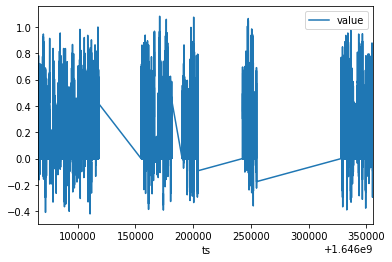

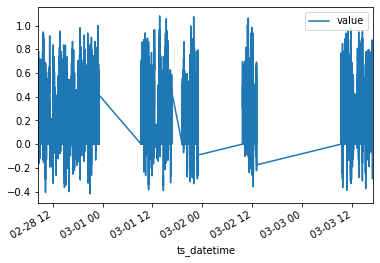

In [32]:
sample_metric_df = pd.concat(metric_dfs['headdown']).\
    sort_values('ts')

sample_metric_df.plot(x='ts',y='value')
sample_metric_df.\
    groupby('date').\
    agg({'value':['mean', 'median'],'ts':'count', 'session_name':'nunique'})#['value'].quantile(np.arange(0, 1,0.1))
    
    
sample_metric_df.\
    assign(ts_datetime=sample_metric_df['ts'].apply(ts_to_datetime)).plot(x='ts_datetime',y='value')
  
sample_metric_df = sample_metric_df.\
    assign(ts_datetime=sample_metric_df['ts'].apply(ts_to_datetime))

In [33]:
def create_daiy_df(start_date: str, end_date: str, hours:list, freq="1s"):
    ts = pd.date_range(start_date, end_date, freq=freq)
    df = pd.DataFrame({'ts':ts})
    df['hour'] = df['ts'].apply(lambda datetime: datetime.hour)
    df = df[df['hour'].isin(hours)]
    return df

In [34]:
daily_df = create_daiy_df('2022-02-28', '2022-03-06', hours=np.arange(6, 22, 1))

In [35]:
daily_df_merged = \
    daily_df.\
    merge(sample_metric_df, left_on='ts', right_on='ts_datetime', how='left')[['ts_x', 'value']].fillna(-1)
daily_df_merged['date'] = daily_df_merged['ts_x'].apply(lambda datetime: str(datetime.date()))

In [36]:
daily_df_merged['time']= daily_df_merged['ts_x'].apply(lambda datetime: str(datetime)[11:])

In [37]:
daily_df_merged

,ts_x,value,date,time
0,2022-02-28 06:00:00,-1.0,2022-02-28,06:00:00
1,2022-02-28 06:00:01,-1.0,2022-02-28,06:00:01
2,2022-02-28 06:00:02,-1.0,2022-02-28,06:00:02
3,2022-02-28 06:00:03,-1.0,2022-02-28,06:00:03
4,2022-02-28 06:00:04,-1.0,2022-02-28,06:00:04
...,...,...,...,...
345595,2022-03-05 21:59:55,-1.0,2022-03-05,21:59:55
345596,2022-03-05 21:59:56,-1.0,2022-03-05,21:59:56
345597,2022-03-05 21:59:57,-1.0,2022-03-05,21:59:57
345598,2022-03-05 21:59:58,-1.0,2022-03-05,21:59:58


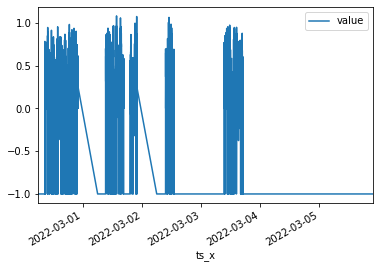

In [38]:
daily_df_merged.plot(x='ts_x', y='value')

In [39]:
import plotly.graph_objects as go
import datetime
import numpy as np

fig = go.Figure(data=go.Heatmap(
        z=daily_df_merged['value'],
        y=daily_df_merged['time'],
        x=daily_df_merged['date'],
        colorscale='Viridis'))

fig.update_layout(
    title='Posture Monitoring Coverage')

fig.show()

In [45]:
len(metric_dfs)
metric_dfs.keys()

dict_keys(['alert_ts', 'good_posture', 'headdown', 'headdown_seconds', 'landmark_0_x', 'landmark_0_y', 'landmark_10_x', 'landmark_10_y', 'landmark_11_x', 'landmark_11_y', 'landmark_12_x', 'landmark_12_y', 'landmark_13_x', 'landmark_13_y', 'landmark_14_x', 'landmark_14_y', 'landmark_1_x', 'landmark_1_y', 'landmark_2_x', 'landmark_2_y', 'landmark_3_x', 'landmark_3_y', 'landmark_4_x', 'landmark_4_y', 'landmark_5_x', 'landmark_5_y', 'landmark_6_x', 'landmark_6_y', 'landmark_7_x', 'landmark_7_y', 'landmark_8_x', 'landmark_8_y', 'landmark_9_x', 'landmark_9_y', 'left_eye_shoulder_x_diff', 'left_right_shoulder_y_diff', 'left_shoulder_elbow_x_diff', 'left_shoulder_x', 'left_shoulder_y', 'rightshoulder_down_seconds', 'right_eye_shoulder_x_diff', 'right_shoulder_elbow_x_diff', 'right_shoulder_x', 'right_shoulder_y', 'shoulder_tilt_seconds'])

In [61]:
landmark_4_x, landmark_4_y = pd.concat(metric_dfs['landmark_4_x']), pd.concat(metric_dfs['landmark_4_y'])
landmark_1_x, landmark_1_y = pd.concat(metric_dfs['landmark_1_x']), pd.concat(metric_dfs['landmark_1_y'])

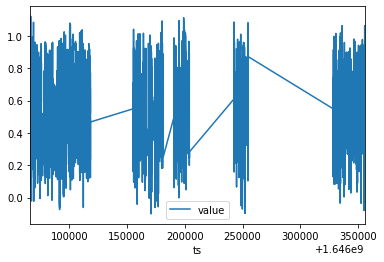

In [57]:
landmark_4_x.plot(x='ts', y='value')

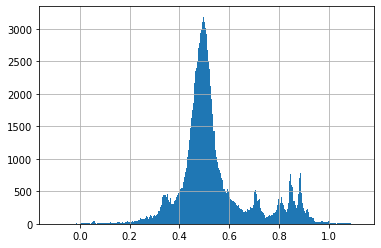

In [59]:
landmark_4_x['value'].hist(bins=300) #0.2 -> 0.5

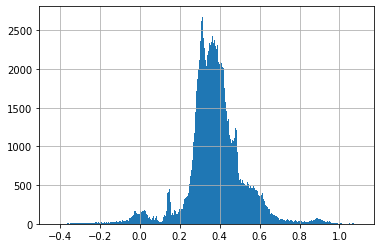

In [60]:
landmark_4_y['value'].hist(bins=300) #0.2 -> 0.5

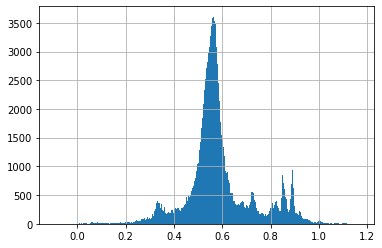

In [62]:
landmark_1_x['value'].hist(bins=300)

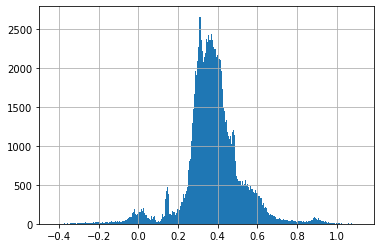

In [66]:
landmark_1_y['value'].hist(bins=300) #0.2 -> 0.5